# MMSegmentation Framework

## Basic immports

Things we have to take into account:
- The dataset is created in . If not, uncomment the code at the end of the next cell.

/home/alberto/anaconda3/envs/openmmlab2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


1.12.0+cu113 True
1.2.2
NVIDIA GeForce RTX 4070 Laptop GPU
loading annotations into memory...
loading annotations into memory...
Done (t=3.62s)
creating index...
index created!
47
47


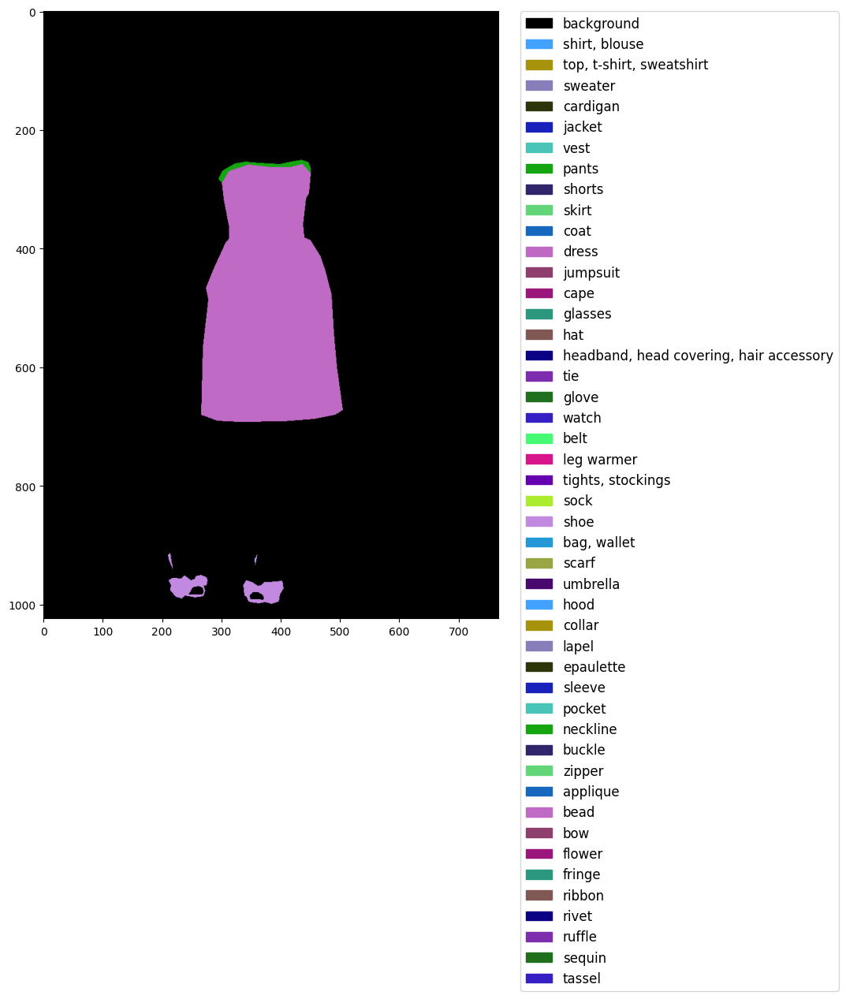

In [1]:
# Check Pytorch installation
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMSegmentation installation
import mmseg
print(mmseg.__version__)

import numpy as np

# check cuda
if torch.cuda.is_available():
    print(torch.cuda.get_device_name(0))

import os
if "mmsegmentation" not in os.getcwd():
    os.chdir("mmsegmentation")

# define dataset root and directory for images and annotations
from src import config
data_root = '../' + config.dataDir
img_dir = os.path.join(data_root, 'images')
ann_dir = os.path.join(data_root, 'annotations')
# define class and palette for better visualization
classes = list(config.d_cats_bg.values())
palette = config.COLORS

print(len(palette))
print(len(classes))

assert len(palette) == len(classes)

# Let's take a look at the segmentation map we got
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import cv2

plt.figure(figsize=(15, 10))
# im = plt.imshow(np.array(img.convert('RGB')))

mask = cv2.imread('../datasets/fashion/annotations/train2020/0a0f64ffdb6aa45b0f445b217b05a6c6_seg.png', cv2.IMREAD_GRAYSCALE)

# For all the values in the mask, we will create a new mask with the same shape but with the color of the category
mask_color = np.zeros((mask.shape[0], mask.shape[1], 3))
for i in range(mask.shape[0]):
    for j in range(mask.shape[1]):
        mask_color[i, j] = palette[mask[i, j]]

mask_color = mask_color.astype(np.uint8)
plt.imshow(mask_color)
# create a patch (proxy artist) for every color 
patches = [mpatches.Patch(color=np.array(palette[i])/255., 
                          label=classes[i]) for i in range(len(classes))]
# put those patched as legend-handles into the legend
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., 
           fontsize='large')

plt.show()

# from mmseg.registry import DATASETS
# from mmseg.datasets import BaseSegDataset


# @DATASETS.register_module()
# class FashionBG(BaseSegDataset):
#   METAINFO = dict(classes = classes, palette = palette)
#   def __init__(self, **kwargs):
#     super().__init__(img_suffix='.jpg', seg_map_suffix='_seg.png', **kwargs)

After downloading the data, we need to implement `load_annotations` function in the new dataset class `StanfordBackgroundDataset`.

### Create a config file
In the next step, we need to modify the config for the training. To accelerate the process, we finetune the model from trained weights.

In [2]:
# Download config and checkpoint files
# !mim download mmsegmentation --config pspnet_r18-d8_4xb4-80k_isaid-896x896 --dest .

In [27]:
def inference_model(config_path, checkpoint_path):    
    from mmengine import Config

    cfg = Config.fromfile(config_path)
    cfg.test_pipeline = [
        dict(type='LoadImageFromFile'),
        dict(type='Resize', scale=(320, 240), keep_ratio=True),
        # add loading annotation after ``Resize`` because ground truth
        # does not need to do resize data transform
        # dict(type='REDLoadAnnotations', ignore_classes=ignore_classes),
        # dict(type='LoadAnnotations'),
        dict(type='PackSegInputs')
    ]

    try:
        cfg.train_dataloader.dataset.type = cfg.dataset_type
        cfg.train_dataloader.dataset.data_root = cfg.data_root
        cfg.train_dataloader.dataset.data_prefix = dict(img_path='images/train2020', seg_map_path='annotations/train2020')
        cfg.train_dataloader.dataset.ann_file = 0
        cfg.train_dataloader.dataset.pipeline = cfg.train_pipeline
        # cfg.train_dataloader.dataset.ann_file = 'splits/train.txt'

        cfg.val_dataloader.dataset.type = cfg.dataset_type
        cfg.val_dataloader.dataset.data_root = cfg.data_root
        cfg.val_dataloader.dataset.data_prefix = dict(img_path='images/val2020', seg_map_path='annotations/val2020')
        cfg.val_dataloader.dataset.ann_file = 0
        cfg.val_dataloader.dataset.pipeline = cfg.val_pipeline
        # cfg.val_dataloader.dataset.ann_file = 'splits/val.txt'

        cfg.val_evaluator = dict(iou_metrics=['mIoU','mDice'], type='IoUMetric', classwise=True, ignore_index=0)

        cfg.test_dataloader = cfg.val_dataloader
        cfg.test_dataloader.dataset.pipeline = cfg.test_pipeline
    except:
        pass

    from mmengine.runner import Runner

    runner = Runner.from_cfg(cfg)
    from mmseg.apis import init_model, inference_model, show_result_pyplot

    model = init_model(cfg, checkpoint_path, 'cuda:0')
    return model

red_model = inference_model('../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192_RED/schedule_40000/fashion_r50_40k_voc12_192x192_RED.py', 
                            '../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192_RED/schedule_40000/iter_40000.pth')
dv3_model = inference_model('../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192/schedule_40000/fashion_r50_40k_voc12_192x192.py',
                            '../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192/schedule_40000/iter_40000.pth')
dv3_model_aug = inference_model('../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192_DATA_AUG/fashion_r50_40k_voc12_192x192_DATA_AUG.py',
                                '../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192_DATA_AUG/iter_40000.pth')

04/22 20:47:22 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Jul  5 2023, 18:54:27) [GCC 11.2.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 0
    GPU 0: NVIDIA GeForce RTX 4070 Laptop GPU
    CUDA_HOME: /usr/lib/cuda
    NVCC: Not Available
    GCC: gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
    PyTorch: 1.12.0+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.6.0 (Git Hash 52b5f107dd9cf10910aaa19cb47f3abf9b349815)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.3
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;

/bin/sh: 1: /usr/lib/cuda/bin/nvcc: not found


04/22 20:47:22 - mmengine - INFO - Config:
cfg = dict(
    crop_size=(
        192,
        192,
    ),
    data_preprocessor=dict(
        bgr_to_rgb=True,
        mean=[
            123.675,
            116.28,
            103.53,
        ],
        pad_val=0,
        seg_pad_val=255,
        std=[
            58.395,
            57.12,
            57.375,
        ],
        type='SegDataPreProcessor'),
    data_root='../datasets/fashion/',
    dataset_type='FashionBG',
    default_hooks=dict(
        checkpoint=dict(by_epoch=False, interval=4000, type='CheckpointHook'),
        logger=dict(interval=50, log_metric_by_epoch=False, type='LoggerHook'),
        param_scheduler=dict(type='ParamSchedulerHook'),
        sampler_seed=dict(type='DistSamplerSeedHook'),
        timer=dict(type='IterTimerHook'),
        visualization=dict(type='SegVisualizationHook')),
    default_scope='mmseg',
    env_cfg=dict(
        cudnn_benchmark=True,
        dist_cfg=dict(backend='nccl'),
        mp_cfg

/home/alberto/anaconda3/envs/openmmlab2/lib/python3.10/site-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmseg.visualization.local_visualizer.SegLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/home/alberto/Documentos/GitHub/OR_FashionParsing/mmsegmentation/mmseg/models/backbones/resnet.py:431: UserWarning: DeprecationWarning: pretrained is a deprecated, please use "init_cfg" instead
  warnings.warn('DeprecationWarning: pretrained is a deprecated, '
/home/alberto/Documentos/GitHub/OR_FashionParsing/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:250: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  warnings.warn(


04/22 20:47:23 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
04/22 20:47:23 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
 -------------------- 
before_train_iter:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
 -------------------- 
after_train_iter:
(VERY_HIGH   ) RuntimeInfoHook                

/home/alberto/Documentos/GitHub/OR_FashionParsing/mmsegmentation/mmseg/engine/hooks/visualization_hook.py:60: UserWarning: The draw is False, it means that the hook for visualization will not take effect. The results will NOT be visualized or stored.
  warnings.warn('The draw is False, it means that the '


Loads checkpoint by local backend from path: ../experiments/deeplabv3_fashion_r50_40k_voc12/resol_192_RED/schedule_40000/iter_40000.pth
04/22 20:47:25 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Jul  5 2023, 18:54:27) [GCC 11.2.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 0
    GPU 0: NVIDIA GeForce RTX 4070 Laptop GPU
    CUDA_HOME: /usr/lib/cuda
    NVCC: Not Available
    GCC: gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
    PyTorch: 1.12.0+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.6.0 (Git Hash 52b5f107dd9cf10910aaa19cb47f3abf9b349815)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability

/bin/sh: 1: /usr/lib/cuda/bin/nvcc: not found


04/22 20:47:26 - mmengine - INFO - Config:
cfg = dict(
    crop_size=(
        192,
        192,
    ),
    data_preprocessor=dict(
        bgr_to_rgb=True,
        mean=[
            123.675,
            116.28,
            103.53,
        ],
        pad_val=0,
        seg_pad_val=255,
        std=[
            58.395,
            57.12,
            57.375,
        ],
        type='SegDataPreProcessor'),
    data_root='../datasets/fashion/',
    dataset_type='FashionBG',
    default_hooks=dict(
        checkpoint=dict(by_epoch=False, interval=4000, type='CheckpointHook'),
        logger=dict(interval=50, log_metric_by_epoch=False, type='LoggerHook'),
        param_scheduler=dict(type='ParamSchedulerHook'),
        sampler_seed=dict(type='DistSamplerSeedHook'),
        timer=dict(type='IterTimerHook'),
        visualization=dict(type='SegVisualizationHook')),
    default_scope='mmseg',
    env_cfg=dict(
        cudnn_benchmark=True,
        dist_cfg=dict(backend='nccl'),
        mp_cfg

/bin/sh: 1: /usr/lib/cuda/bin/nvcc: not found


04/22 20:47:29 - mmengine - INFO - Config:
cfg = dict(
    crop_size=(
        192,
        192,
    ),
    data_preprocessor=dict(
        bgr_to_rgb=True,
        mean=[
            123.675,
            116.28,
            103.53,
        ],
        pad_val=0,
        seg_pad_val=255,
        std=[
            58.395,
            57.12,
            57.375,
        ],
        type='SegDataPreProcessor'),
    data_root='../datasets/fashion/',
    dataset_type='FashionBG',
    default_hooks=dict(
        checkpoint=dict(by_epoch=False, interval=4000, type='CheckpointHook'),
        logger=dict(interval=50, log_metric_by_epoch=False, type='LoggerHook'),
        param_scheduler=dict(type='ParamSchedulerHook'),
        sampler_seed=dict(type='DistSamplerSeedHook'),
        timer=dict(type='IterTimerHook'),
        visualization=dict(type='SegVisualizationHook')),
    default_scope='mmseg',
    env_cfg=dict(
        cudnn_benchmark=True,
        dist_cfg=dict(backend='nccl'),
        mp_cfg

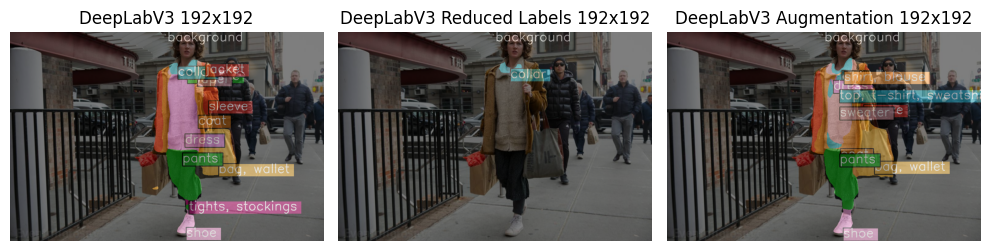

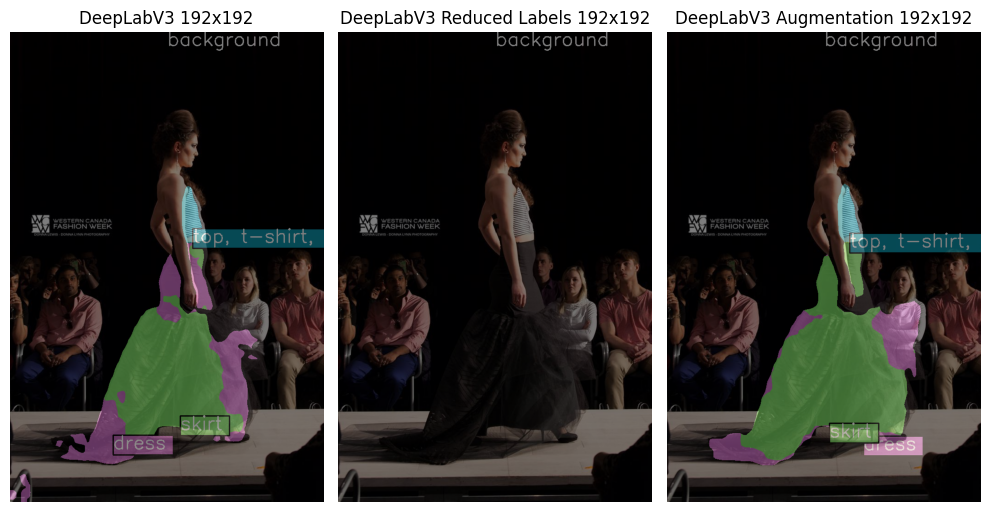

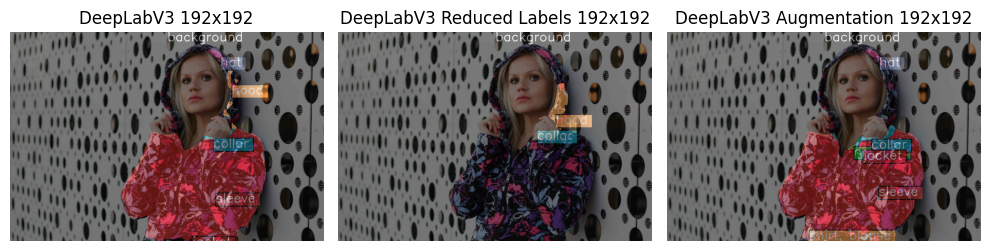

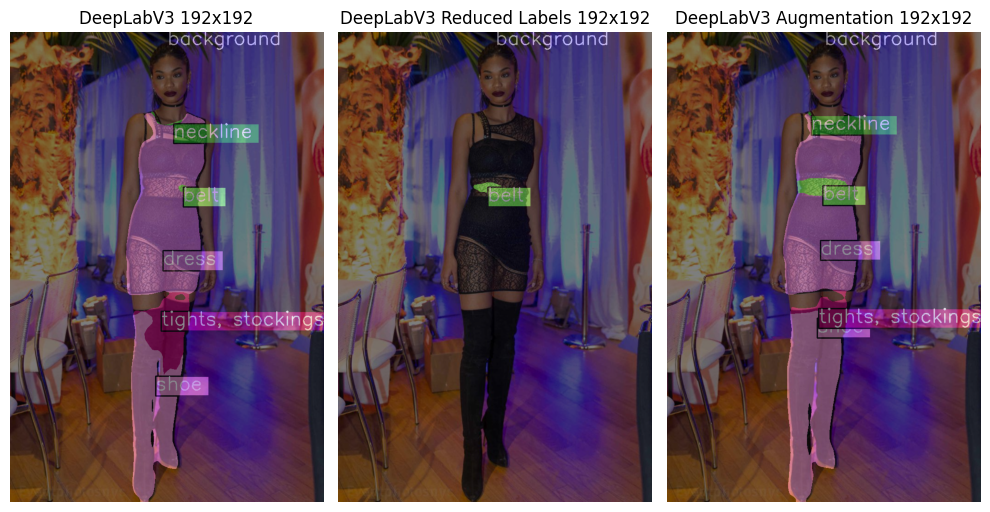

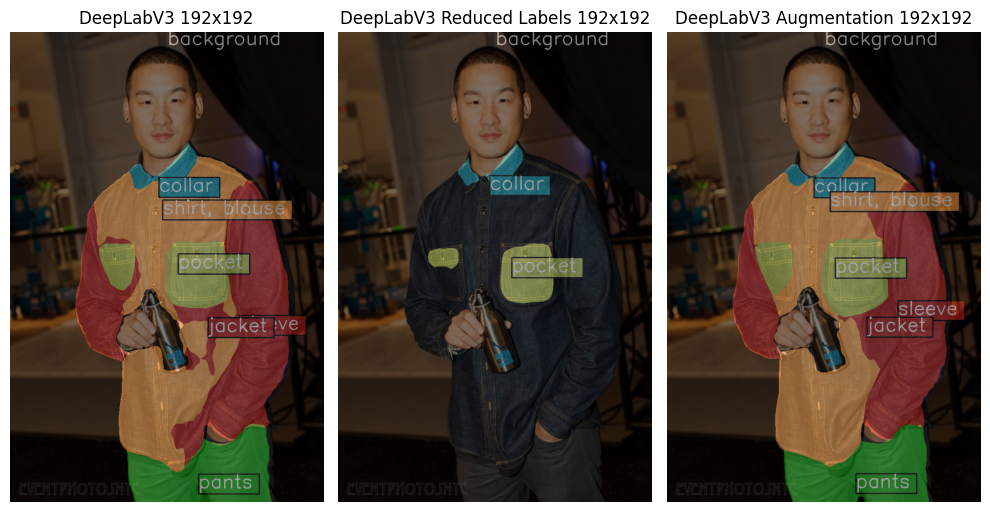

...

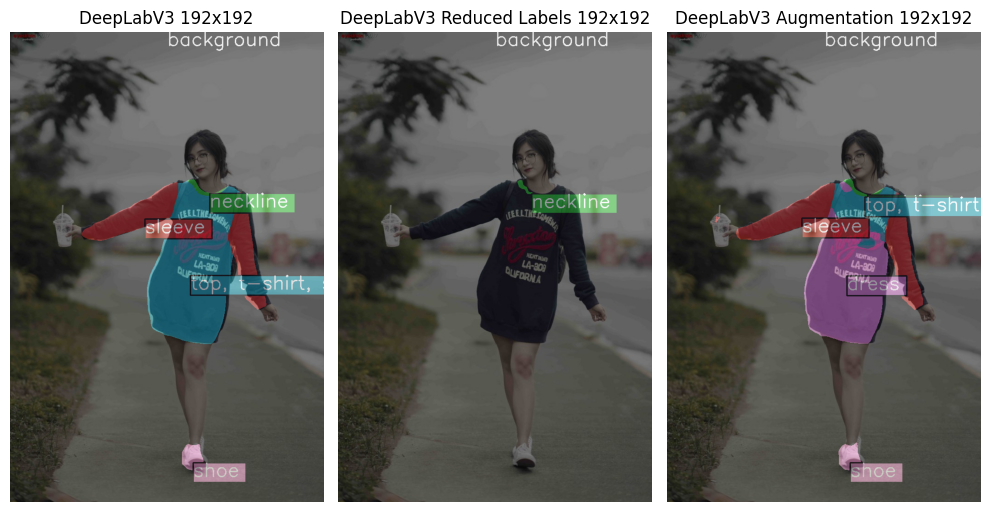

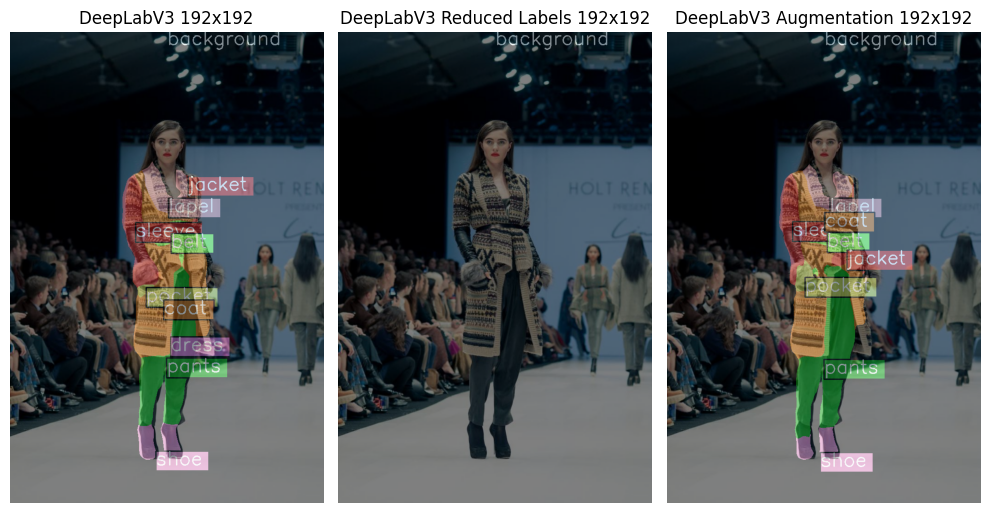

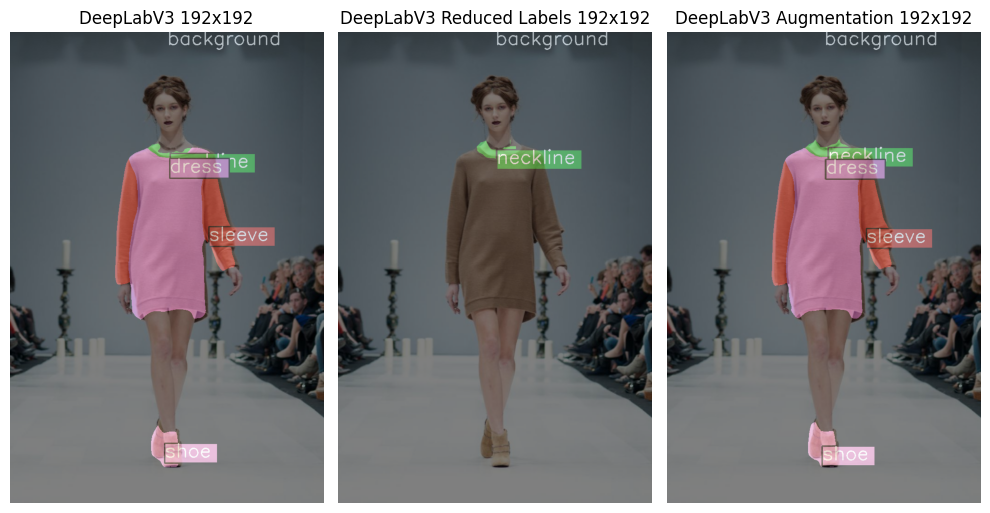

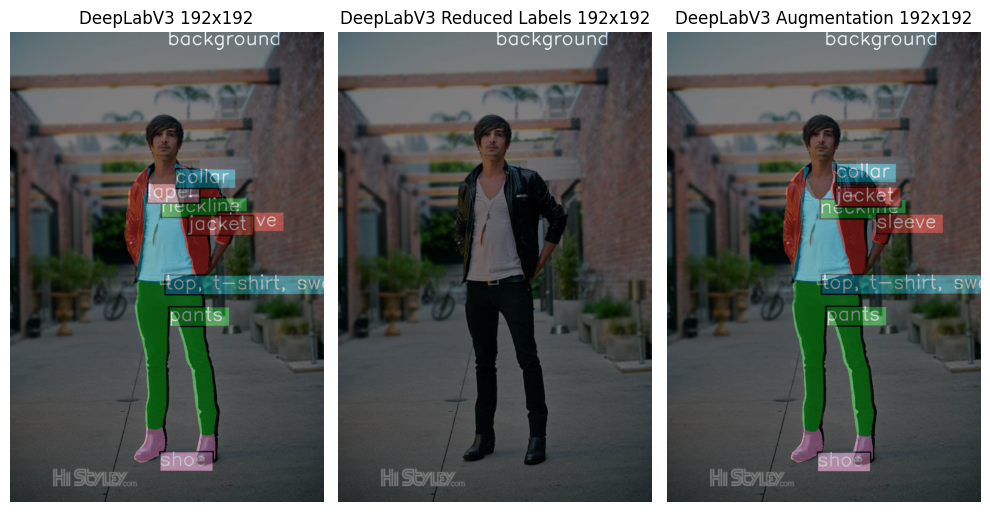

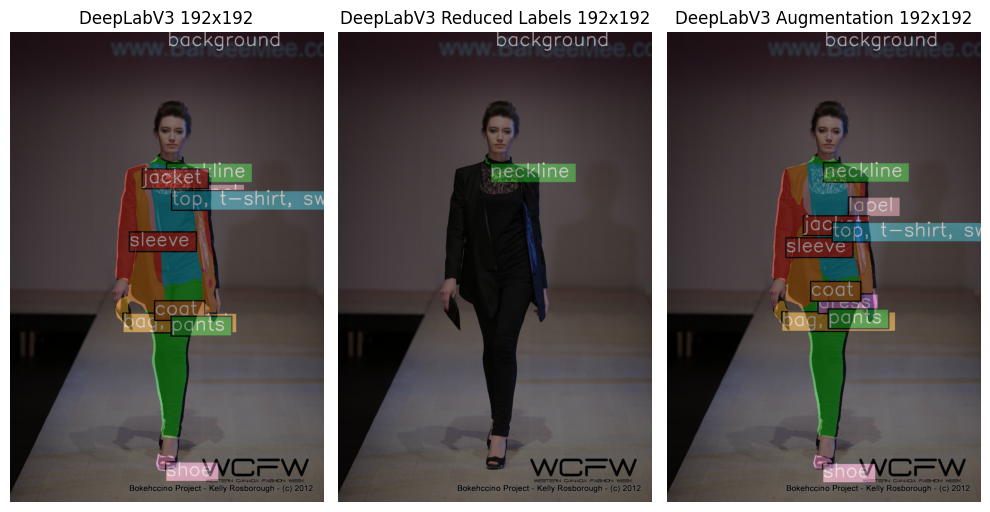

In [31]:
import mmcv
import matplotlib.pyplot as plt
from mmseg.apis import init_model, inference_model, show_result_pyplot

n=50
for i in range(n):
    fig, ax = plt.subplots(1, 3, figsize=(10, 15))
    ls_test = os.listdir('../datasets/fashion/images/test2020')
    img = mmcv.imread(f'../datasets/fashion/images/test2020/{ls_test[i]}')
    result = inference_model(red_model, img)
    result_orig = inference_model(dv3_model, img)
    result_aug = inference_model(dv3_model_aug, img)
    # plt.figure(figsize=(8, 6))
    vis_result = show_result_pyplot(red_model, img, result)
    vis_result_orig = show_result_pyplot(dv3_model, img, result_orig)
    vis_result_aug = show_result_pyplot(dv3_model_aug, img, result_aug)

    ax[0].imshow(mmcv.bgr2rgb(vis_result_orig))
    ax[1].imshow(mmcv.bgr2rgb(vis_result))
    ax[2].imshow(mmcv.bgr2rgb(vis_result_aug))

    ax[0].set_title('DeepLabV3 192x192')
    ax[1].set_title('DeepLabV3 Reduced Labels 192x192')
    ax[2].set_title('DeepLabV3 Augmentation 192x192')

    ax[0].axis('off')
    ax[1].axis('off')
    ax[2].axis('off')
    
    plt.tight_layout()
    plt.show()

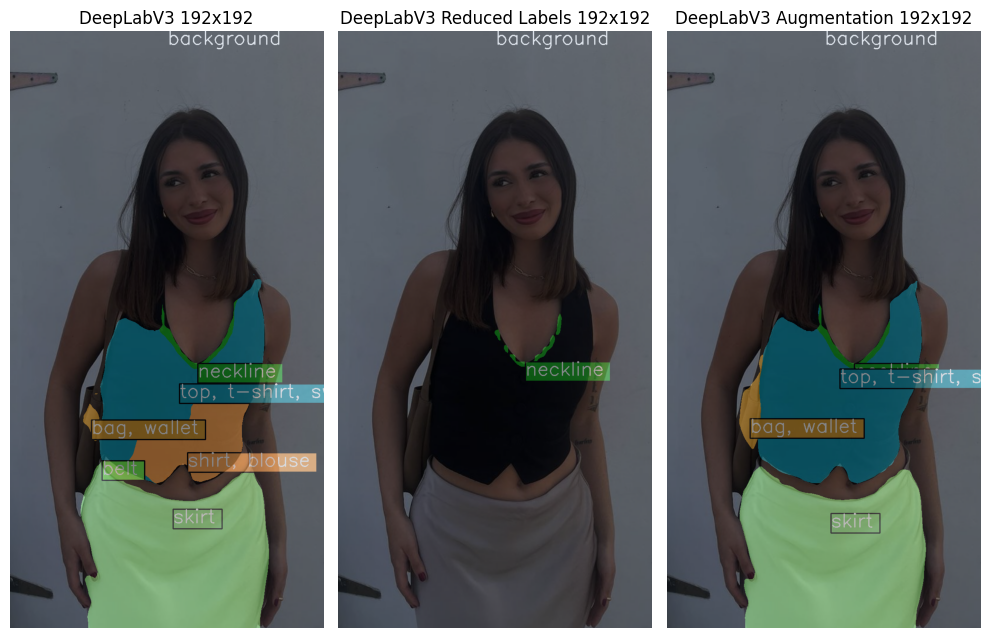

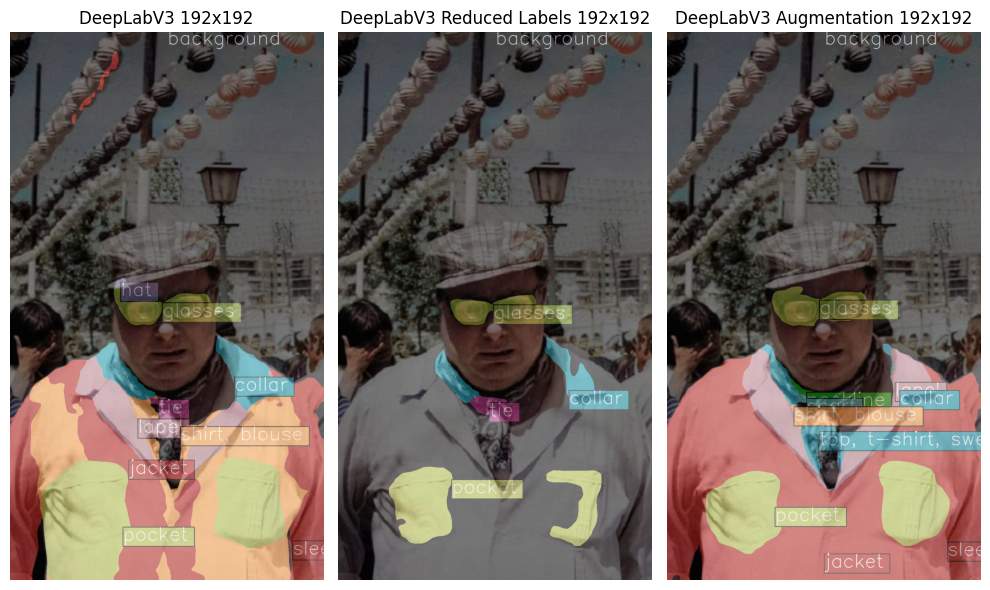

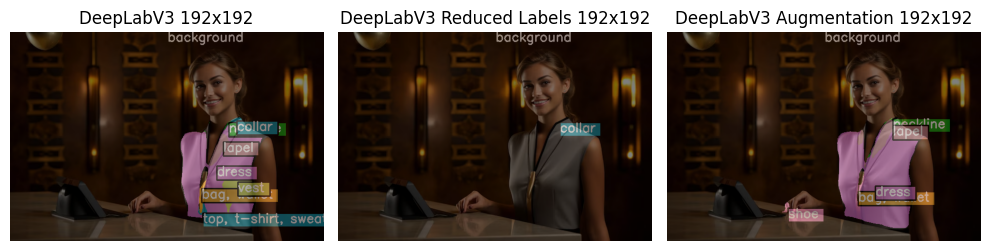

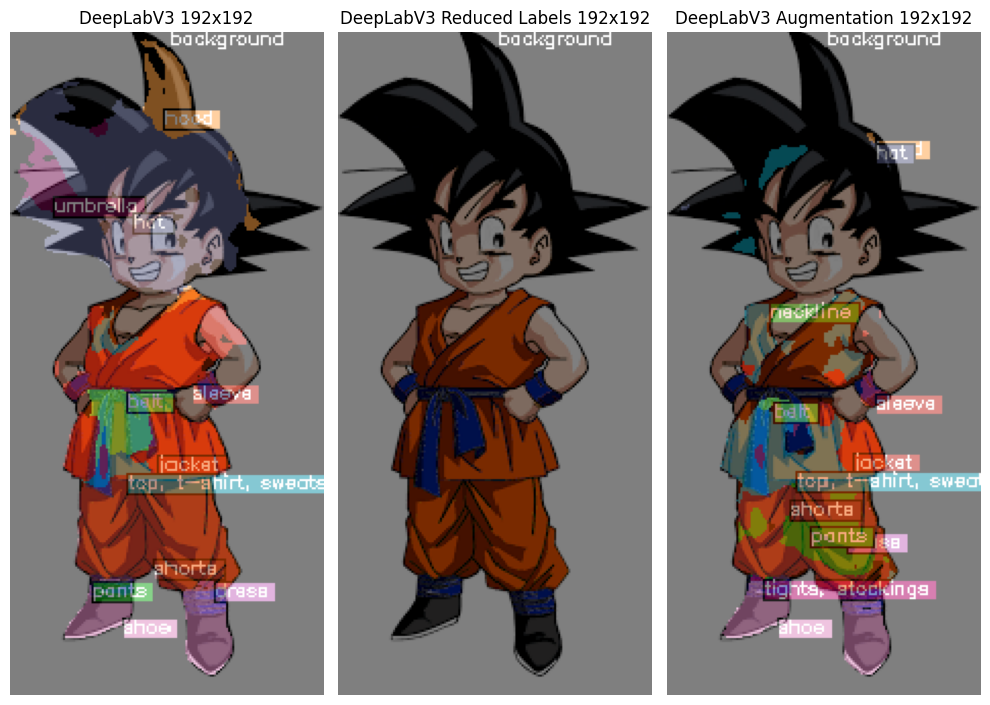

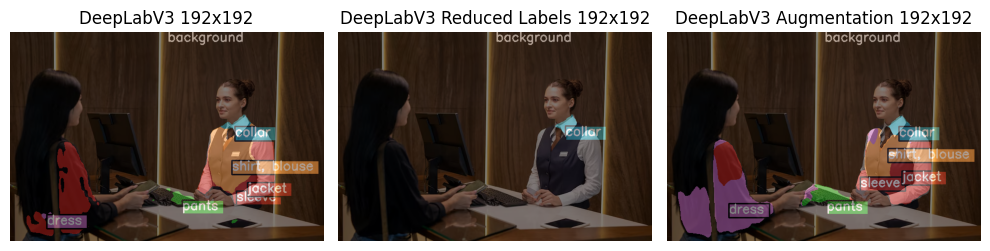

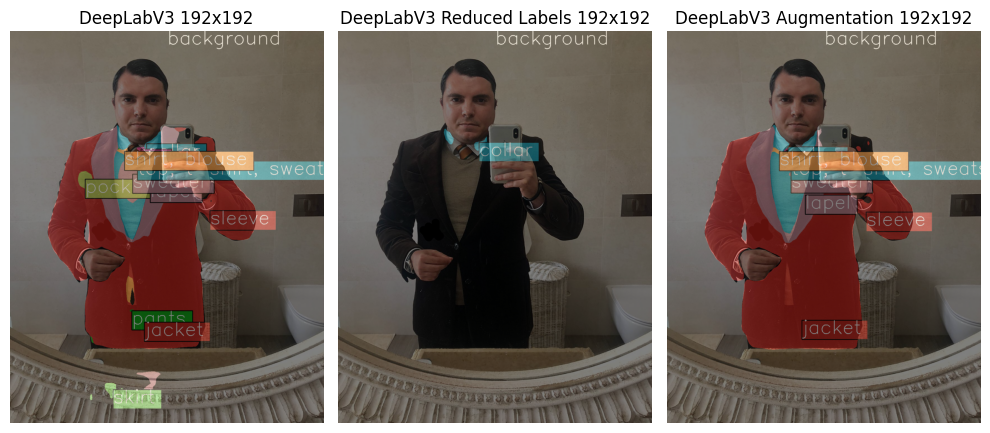

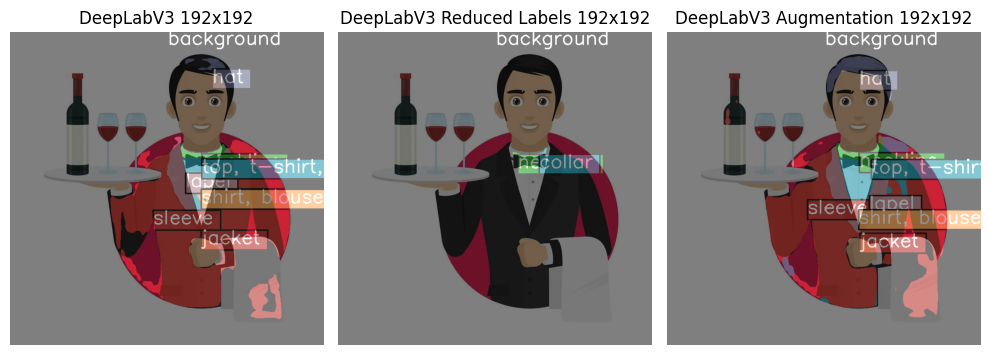

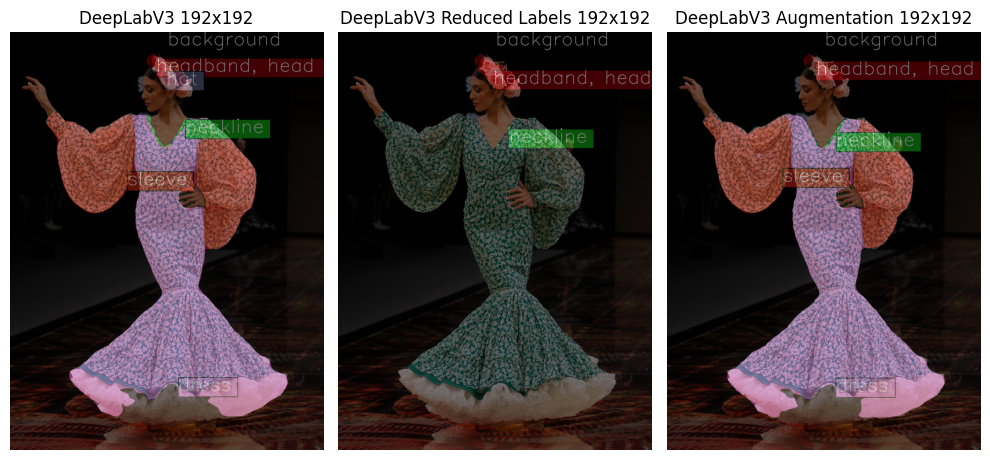

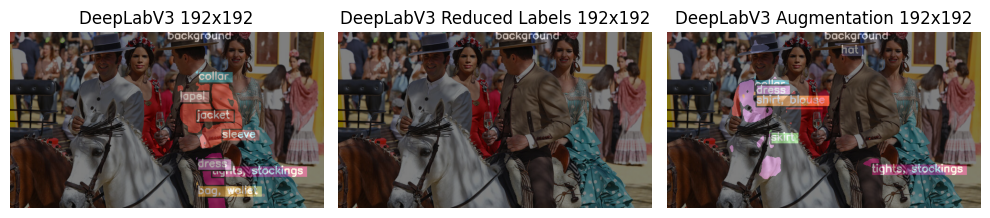

IndexError: list index out of range

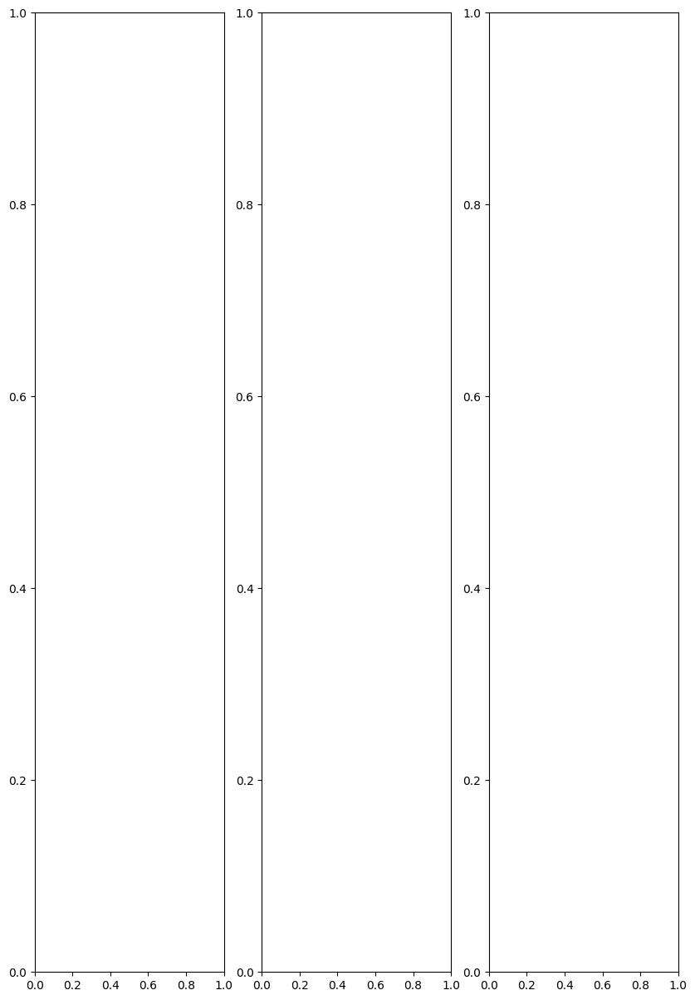

In [35]:
import mmcv
import matplotlib.pyplot as plt
from mmseg.apis import init_model, inference_model, show_result_pyplot

n=10
for i in range(n):
    fig, ax = plt.subplots(1, 3, figsize=(10, 15))
    ls_test = os.listdir('../datasets/others')
    img = mmcv.imread(f'../datasets/others/{ls_test[i]}')
    result = inference_model(red_model, img)
    result_orig = inference_model(dv3_model, img)
    result_aug = inference_model(dv3_model_aug, img)
    # plt.figure(figsize=(8, 6))
    vis_result = show_result_pyplot(red_model, img, result)
    vis_result_orig = show_result_pyplot(dv3_model, img, result_orig)
    vis_result_aug = show_result_pyplot(dv3_model_aug, img, result_aug)

    ax[0].imshow(mmcv.bgr2rgb(vis_result_orig))
    ax[1].imshow(mmcv.bgr2rgb(vis_result))
    ax[2].imshow(mmcv.bgr2rgb(vis_result_aug))

    ax[0].set_title('DeepLabV3 192x192')
    ax[1].set_title('DeepLabV3 Reduced Labels 192x192')
    ax[2].set_title('DeepLabV3 Augmentation 192x192')

    ax[0].axis('off')
    ax[1].axis('off')
    ax[2].axis('off')
    
    plt.tight_layout()
    plt.show()

Since the given config is used to train PSPNet on the cityscapes dataset, we need to modify it accordingly for our new dataset.  

### Train and Evaluation

Inference with trained model

In [12]:
print(os.getcwd())

/home/alberto/Documentos/GitHub/OR_FashionParsing/mmsegmentation


Loads checkpoint by local backend from path: work_dirs/fashion_r50_40k_voc12_192x192_RED/schedule_200/resol_192/iter_200.pth


/home/alberto/anaconda3/envs/openmmlab2/lib/python3.10/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


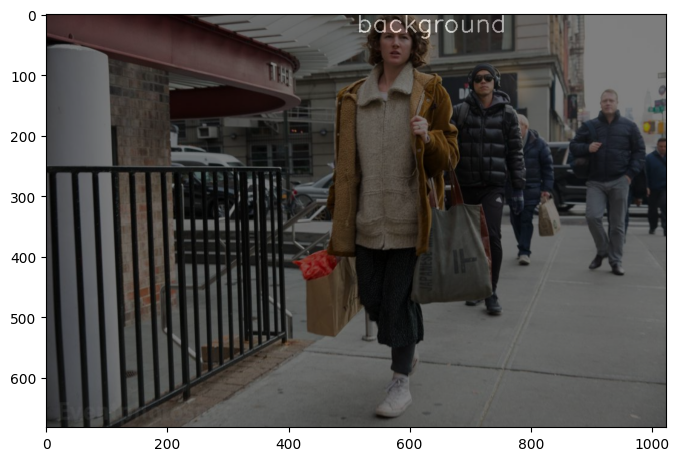

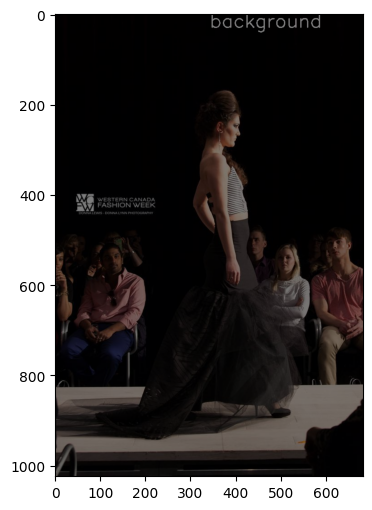

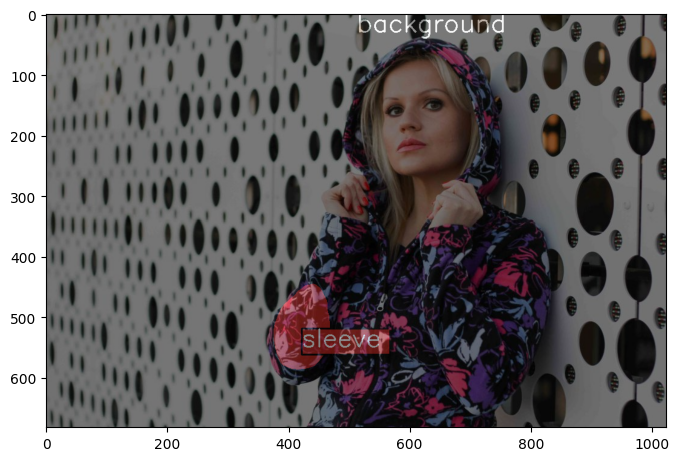

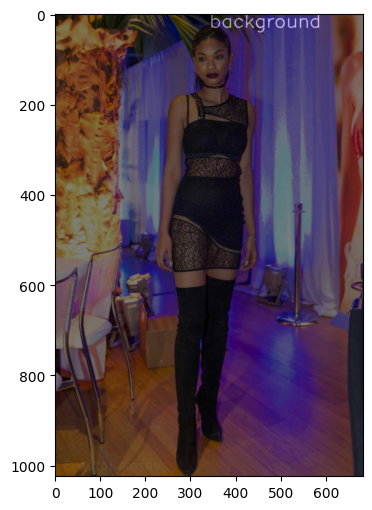

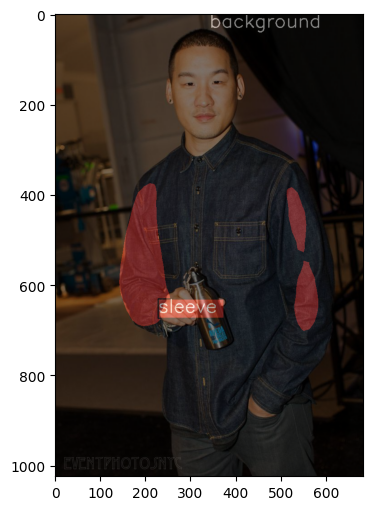

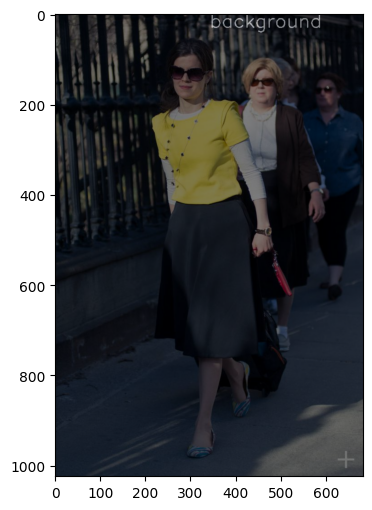

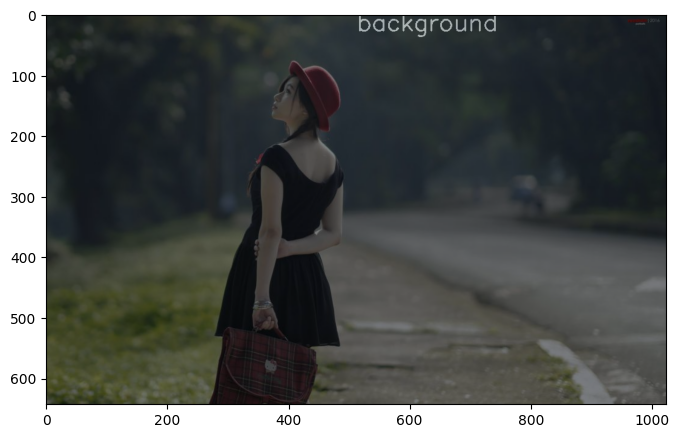

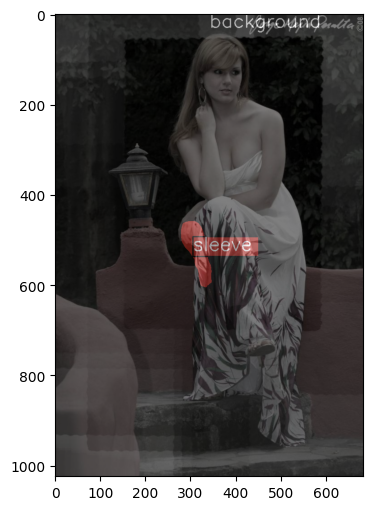

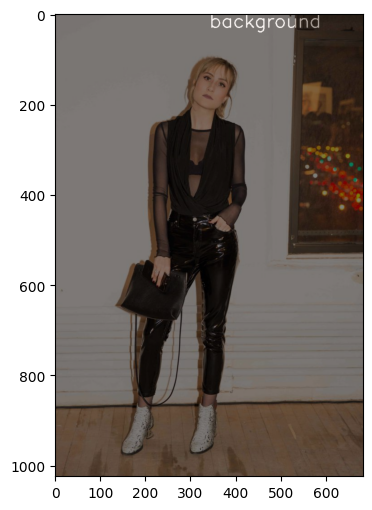

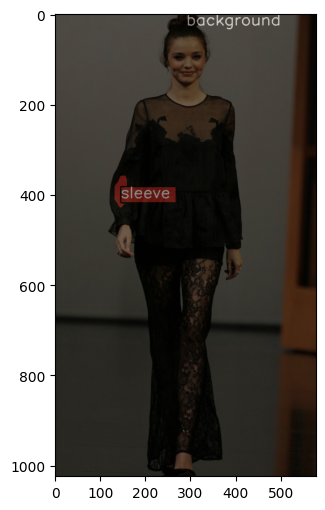

In [14]:

# Init the model from the config and the checkpoint
checkpoint_path = 'work_dirs/fashion_r50_40k_voc12_192x192_RED/schedule_200/resol_192/iter_200.pth'
model = init_model(cfg, checkpoint_path, 'cuda:0')

for i in range(10):
    ls_test = os.listdir('../datasets/fashion/images/test2020')
    img = mmcv.imread(f'../datasets/fashion/images/test2020/{ls_test[i]}')
    result = inference_model(model, img)
    plt.figure(figsize=(8, 6))
    vis_result = show_result_pyplot(model, img, result)
    plt.imshow(mmcv.bgr2rgb(vis_result))
    plt.show()


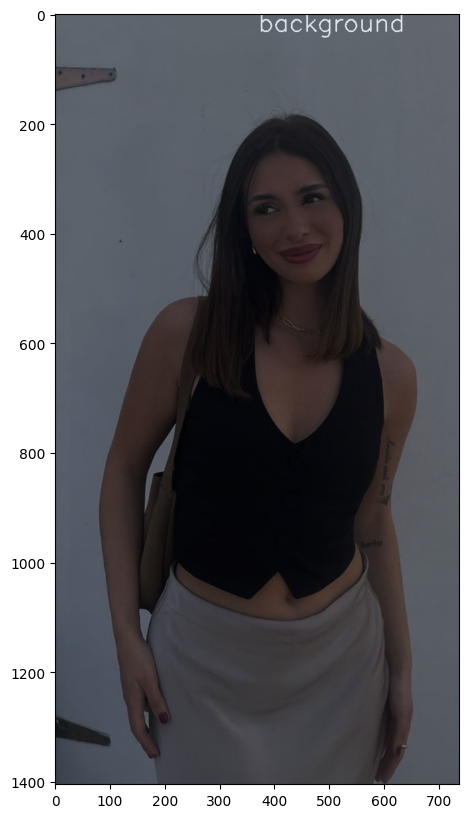

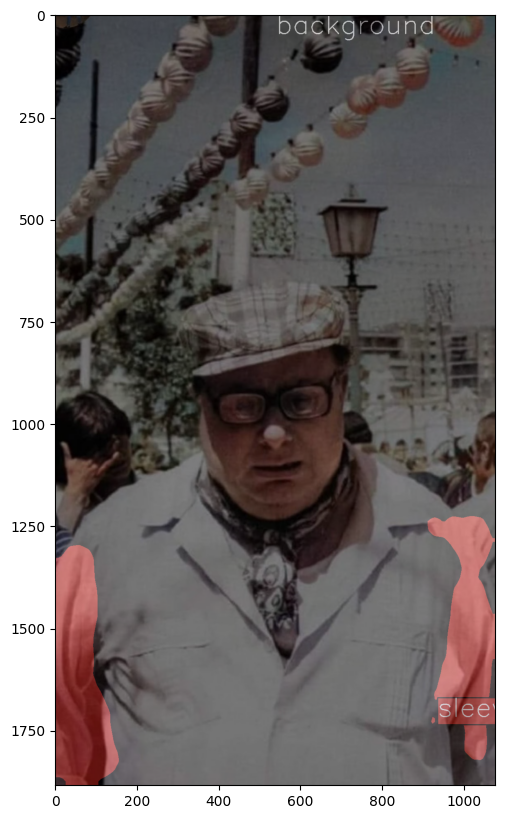

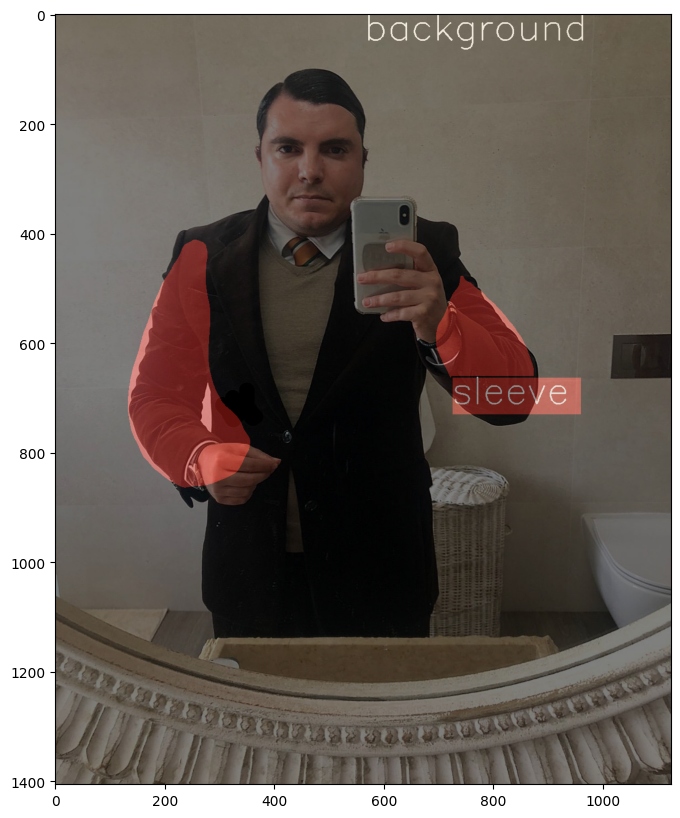

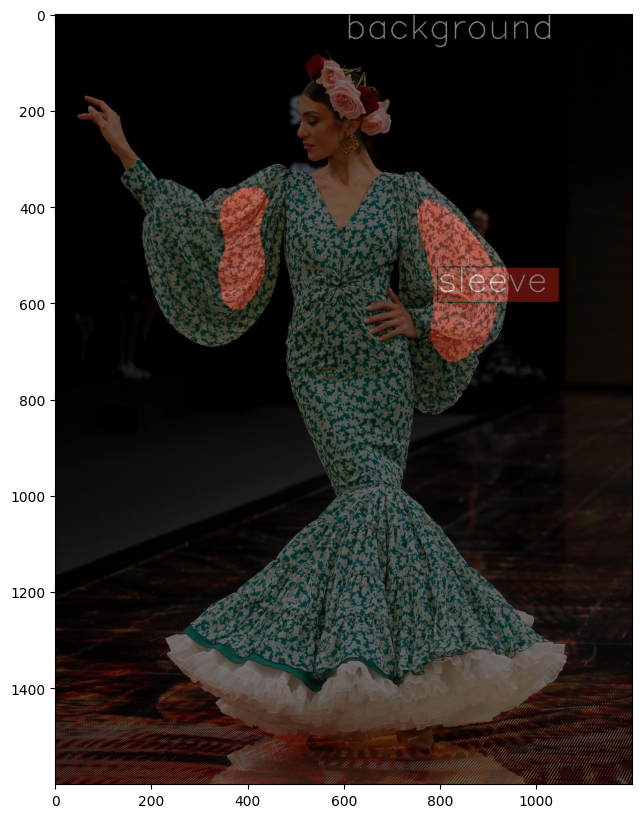

In [15]:
ls_others = os.listdir('../datasets/others/')

for i in range(len(ls_others)):
    img = mmcv.imread(f'../datasets/others/{ls_others[i]}')
    result = inference_model(model, img)
    plt.figure(figsize=(10, 10))
    vis_result = show_result_pyplot(model, img, result)
    plt.imshow(mmcv.bgr2rgb(vis_result))
    plt.show()